In [2]:
from ameisedataset import core as Ameise

# open a record file and access data
infos, frames = Ameise.unpack_record("samples/OneFrameTest.4mse")
print(frames[-1].images[Ameise.Camera.STEREO_LEFT].get_timestamp())
print(infos.camera[Ameise.Camera.STEREO_LEFT].camera_mtx)

2023-08-21 17:48:44.315975536
[[1.76363668e+03 0.00000000e+00 9.49175531e+02]
 [0.00000000e+00 1.76714040e+03 6.18233716e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]


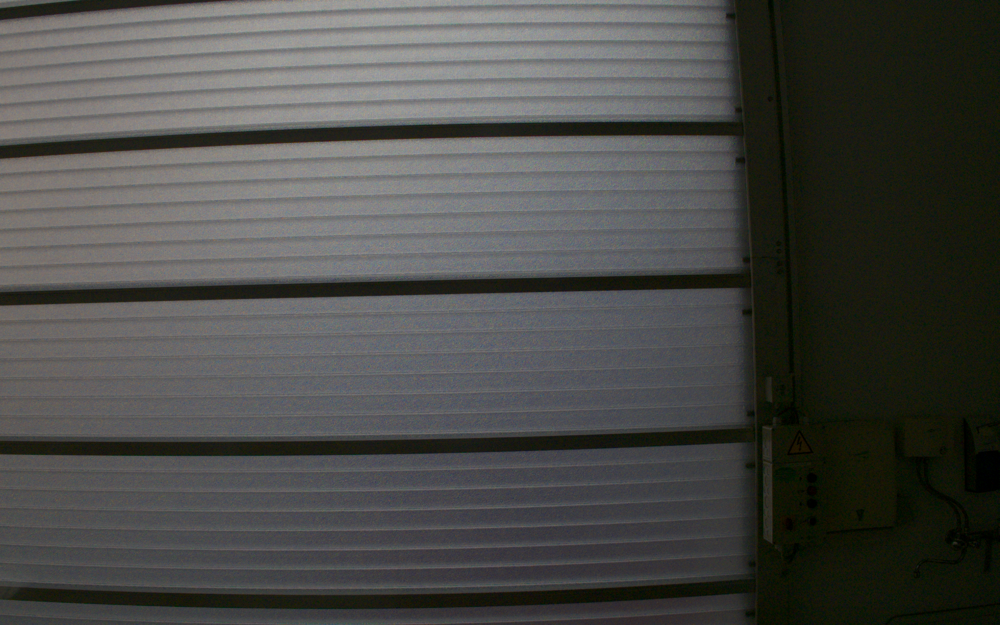

In [3]:
# display an image
frames[-1].images[Ameise.Camera.STEREO_LEFT].image

In [6]:
!pip install plotly
import plotly.graph_objects as go

point_cloud = frames[-1].points[Ameise.Lidar.OS1_TOP].points

x = point_cloud['x']
y = point_cloud['y']
z = point_cloud['z']
intensity = point_cloud['intensity']
range_val = point_cloud['range']

# Punktewolke mit plotly erstellen
fig = go.Figure(data=[go.Scatter3d(
    x=x,
    y=y,
    z=z,
    mode='markers',
    marker=dict(
        size=2,  # Sie können die Größe nach Bedarf anpassen
        color=range_val,  # Setzen Sie die Farbe auf die Intensitätswerte
        colorscale='Viridis',  # Wählen Sie eine Farbskala
        opacity=0.8,
        colorbar=dict(title='Intensity')
    )
)])

# Achsentitel und Layout festlegen
fig.update_layout(
    margin=dict(l=0, r=0, b=0, t=0),
    scene=dict(
        xaxis_title='X',
        yaxis_title='Y',
        zaxis_title='Z'
    )
)

# Anzeigen
fig.show()


[notice] A new release of pip available: 22.3.1 -> 23.2.1
[notice] To update, run: pip install --upgrade pip
